In [1]:
from torcheeg.datasets import SEEDDataset
from torcheeg import transforms
raw_dataset = SEEDDataset(
    root_path='D:/FAST/EEg-based-Emotion-Recognition/Preprocessed_EEG',
    io_path='D:/FAST/EEg-based-Emotion-Recognition/.torcheeg/datasets_1733174610032_5iJyS',
    online_transform=None,
    label_transform=None,
    num_worker=4
)

raw_sample = raw_dataset[0]
print(f"Raw EEG data shape: {raw_sample[0].shape}")

[2024-12-05 00:21:13] INFO (torcheeg/MainThread) 🔍 | Detected cached processing results, reading cache from D:/FAST/EEg-based-Emotion-Recognition/.torcheeg/datasets_1733174610032_5iJyS.


Raw EEG data shape: (62, 200)


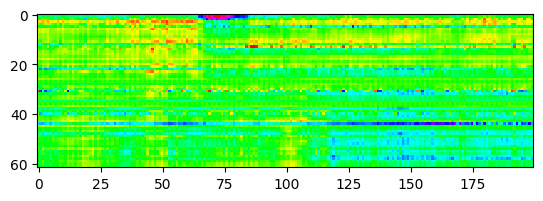

In [2]:
import torch
from torcheeg.utils import plot_2d_tensor

img = plot_2d_tensor(torch.tensor(raw_sample[0]))

In [3]:
from torcheeg.model_selection import LeaveOneSubjectOut
from torch.utils.data import DataLoader


print(f"Dataset size: {len(raw_sample)}")
print(f"Sample format: {raw_dataset[0]}")  # Check a single sample

Dataset size: 2
Sample format: (array([[-19.28210258,  -9.29832458, -25.77900887, ..., -15.55681229,
        -17.49396324, -19.90795135],
       [ 11.92092896,  20.53380013,  11.41428947, ...,   3.21865082,
         -1.16229057,  13.76867294],
       [  0.56624413,  18.80526543, -11.08646393, ..., -26.4942646 ,
        -23.66304398,   8.31484795],
       ...,
       [  3.4570694 ,  10.72883606,  -6.7949295 , ...,  12.54677773,
         10.46061516,  14.42432404],
       [  5.24520874,  11.77191734,  -3.66568565, ...,  15.07997513,
         11.41428947,  20.02716064],
       [  9.08970833,   6.34789467,   1.16229057, ...,  10.37120819,
         12.54677773,  17.94099808]]), {'start_at': 0, 'end_at': 200, 'clip_id': '10_20131130.mat_0', 'subject_id': 10, 'trial_id': 'ww_eeg1', 'emotion': 1, 'date': 20131130, '_record_id': '_record_0'})


In [5]:
print(f"Dataset contains {len(raw_dataset)} samples.")
for i in range(len(raw_dataset)):
    print(raw_dataset[i][1])  # Print metadata for each sample


Dataset contains 152730 samples.
{'start_at': 0, 'end_at': 200, 'clip_id': '10_20131130.mat_0', 'subject_id': 10, 'trial_id': 'ww_eeg1', 'emotion': 1, 'date': 20131130, '_record_id': '_record_0'}
{'start_at': 200, 'end_at': 400, 'clip_id': '10_20131130.mat_1', 'subject_id': 10, 'trial_id': 'ww_eeg1', 'emotion': 1, 'date': 20131130, '_record_id': '_record_0'}
{'start_at': 400, 'end_at': 600, 'clip_id': '10_20131130.mat_2', 'subject_id': 10, 'trial_id': 'ww_eeg1', 'emotion': 1, 'date': 20131130, '_record_id': '_record_0'}
{'start_at': 600, 'end_at': 800, 'clip_id': '10_20131130.mat_3', 'subject_id': 10, 'trial_id': 'ww_eeg1', 'emotion': 1, 'date': 20131130, '_record_id': '_record_0'}
{'start_at': 800, 'end_at': 1000, 'clip_id': '10_20131130.mat_4', 'subject_id': 10, 'trial_id': 'ww_eeg1', 'emotion': 1, 'date': 20131130, '_record_id': '_record_0'}
{'start_at': 1000, 'end_at': 1200, 'clip_id': '10_20131130.mat_5', 'subject_id': 10, 'trial_id': 'ww_eeg1', 'emotion': 1, 'date': 20131130, '_r

In [4]:
for i, sample in enumerate(raw_dataset):
    assert sample[0].shape == (62, 200), f"Mismatch at sample {i}"

In [5]:
from sklearn.preprocessing import StandardScaler

def normalize_sample(eeg_data):
    scaler = StandardScaler()
    normalized_data = scaler.fit_transform(eeg_data.T).T
    return normalized_data

normalized_dataset = [
    (normalize_sample(sample[0]), sample[1]) for sample in raw_dataset
]

In [6]:
def segment_data(eeg_data, segment_length=50, step_size=20):
    segments = []
    for start in range(0, eeg_data.shape[1] - segment_length + 1, step_size):
        segments.append(eeg_data[:, start:start + segment_length])
    return segments

segmented_dataset = [
    (segment, metadata) for sample, metadata in normalized_dataset
    for segment in segment_data(sample)
]


In [7]:
subject_groups = {}
for sample, metadata in segmented_dataset:
    subject_id = metadata['subject_id']
    if subject_id not in subject_groups:
        subject_groups[subject_id] = []
    subject_groups[subject_id].append((sample, metadata))


In [8]:
from torcheeg.model_selection import LeaveOneSubjectOut

loso = LeaveOneSubjectOut()
for train_indices, test_indices in loso.split(subject_groups.keys()):
    train_subjects = [subject_groups[i] for i in train_indices]
    test_subject = [subject_groups[i] for i in test_indices]
    train_data = [sample for subject in train_subjects for sample in subject]
    test_data = [sample for subject in test_subject for sample in subject]


[2024-12-05 00:38:49] INFO (torcheeg/MainThread) 📊 | Create the split of train and test set.
[2024-12-05 00:38:49] INFO (torcheeg/MainThread) 😊 | Please set split_path to .torcheeg\model_selection_1733341129166_yNfyC for the next run, if you want to use the same setting for the experiment.


AttributeError: 'dict_keys' object has no attribute 'info'

In [ ]:
import torch.nn as nn

class BaseEncoder(nn.Module):
    def __init__(self, num_channels=62, spatial_filters=16, temporal_filters=16, kernel_size=3):
        super(BaseEncoder, self).__init__()
        self.spatial_conv = nn.Conv1d(num_channels, spatial_filters, kernel_size=1)
        self.temporal_conv = nn.Conv1d(spatial_filters, temporal_filters, kernel_size=kernel_size, padding=1)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.spatial_conv(x)
        x = self.relu(x)
        x = self.temporal_conv(x)
        x = self.relu(x)
        return x


In [6]:
from torcheeg.datasets import SEEDDataset
import numpy as np
from scipy.signal import butter, filtfilt

def bandpass_filter(data, low_freq, high_freq, sampling_rate):
    nyquist = 0.5 * sampling_rate
    low = low_freq / nyquist
    high = high_freq / nyquist
    b, a = butter(4, [low, high], btype='band')
    return filtfilt(b, a, data)

raw_dataset = SEEDDataset(
    root_path='D:/FAST/EEg-based-Emotion-Recognition/Preprocessed_EEG',
    io_path='D:/FAST/EEg-based-Emotion-Recognition/.torcheeg/datasets_1733174610032_5iJyS',
    online_transform=None,
    label_transform=None,
    num_worker=4
)

preprocessed_data = []
for sample in raw_dataset:
    eeg_data, meta_info = sample
    filtered_signal = np.array([bandpass_filter(channel, 4, 47, 200) for channel in eeg_data])
    meta_info['preprocessed'] = True
    preprocessed_data.append((filtered_signal, meta_info))

print(f"Total samples preprocessed: {len(preprocessed_data)}")
print(f"Sample EEG shape (after preprocessing): {preprocessed_data[0][0].shape}")


[2024-12-03 12:01:46] INFO (torcheeg/MainThread) 🔍 | Detected cached processing results, reading cache from D:/FAST/EEg-based-Emotion-Recognition/.torcheeg/datasets_1733174610032_5iJyS.


KeyboardInterrupt: 